The important cells in this notebook were updated after changing the flow code to minimize relative conductance. However, not all cells have been re-run, so there may be old results in here.

In [1]:
import localgraphclustering as lgc
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.patches import PathPatch
# shapefile names 
riverslakes_shape='ne_50m_rivers_lake_centerlines_scale_rank'
lakes_shape='ne_50m_lakes'


In [2]:
# I don't understand why, but this needs to be in it's own cell...
# plt.rcParams['figure.dpi'] = 300
# Only run this if you want high-quality intermediate figures -- but they get BIG! 

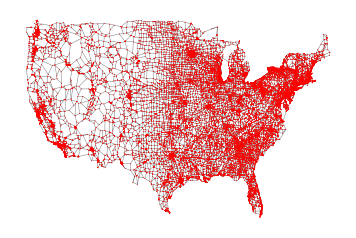

In [3]:
g = lgc.GraphLocal()
g.read_graph("usroads-simplify.edges", separator="\t")
xy = np.loadtxt("usroads-simplify.xy")
g.draw(xy,nodesize=0.5,edgealpha=0.5,linewidth=0.5)

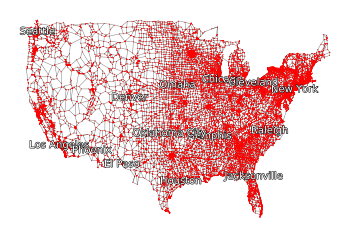

In [4]:
## Get cities mapped
cities_str="""New York	1	New York	4.8	8405837	40.7127837	-74.0059413
Los Angeles	2	California	4.8	3884307	34.0522342	-118.2436849
Chicago	3	Illinois	-6.1	2718782	41.8781136	-87.6297982
Houston	4	Texas	11	2195914	29.7604267	-95.3698028
Philadelphia	5	Pennsylvania	2.6	1553165	39.9525839	-75.1652215
Phoenix	6	Arizona	14	1513367	33.4483771	-112.0740373
San Antonio	7	Texas	21	1409019	29.4241219	-98.4936282
San Diego	8	California	10.5	1355896	32.715738	-117.1610838
Dallas	9	Texas	5.6	1257676	32.7766642	-96.7969879
San Jose	10	California	10.5	998537	37.3382082	-121.8863286
Austin	11	Texas	31.7	885400	30.267153	-97.7430608
Indianapolis	12	Indiana	7.8	843393	39.768403	-86.158068
Jacksonville	13	Florida	14.3	842583	30.3321838	-81.655651
San Francisco	14	California	7.7	837442	37.7749295	-122.4194155
Columbus	15	Ohio	14.8	822553	39.9611755	-82.9987942
Charlotte	16	North Carolina	39.1	792862	35.2270869	-80.8431267
Fort Worth	17	Texas	45.1	792727	32.7554883	-97.3307658
Detroit	18	Michigan	-27.1	688701	42.331427	-83.0457538
El Paso	19	Texas	19.4	674433	31.7775757	-106.4424559
Memphis	20	Tennessee	-5.3	653450	35.1495343	-90.0489801
Seattle	21	Washington	15.6	652405	47.6062095	-122.3320708
Denver	22	Colorado	16.7	649495	39.7392358	-104.990251
Washington	23	District of Columbia	13	646449	38.9071923	-77.0368707
Boston	24	Massachusetts	9.4	645966	42.3600825	-71.0588801
Nashville	25	Tennessee	16.2	634464	36.1626638	-86.7816016
Baltimore	26	Maryland	-4	622104	39.2903848	-76.6121893
Oklahoma City	27	Oklahoma	20.2	610613	35.4675602	-97.5164276
Louisville	28	Kentucky	10	609893	38.2526647	-85.7584557
Portland	29	Oregon	15	609456	45.5230622	-122.6764816
Las Vegas	30	Nevada	24.5	603488	36.1699412	-115.1398296
Milwaukee	31	Wisconsin	0.3	599164	43.0389025	-87.9064736
Albuquerque	32	New Mexico	23.5	556495	35.0853336	-106.6055534
Tucson	33	Arizona	7.5	526116	32.2217429	-110.926479
Fresno	34	California	18.3	509924	36.7468422	-119.7725868
Sacramento	35	California	17.2	479686	38.5815719	-121.4943996
Long Beach	36	California	1.5	469428	33.7700504	-118.1937395
Kansas City	37	Missouri	5.5	467007	39.0997265	-94.5785667
Mesa	38	Arizona	13.5	457587	33.4151843	-111.8314724
Virginia Beach	39	Virginia	5.1	448479	36.8529263	-75.977985
Atlanta	40	Georgia	6.2	447841	33.7489954	-84.3879824
Colorado Springs	41	Colorado	21.4	439886	38.8338816	-104.8213634
Omaha	42	Nebraska	5.9	434353	41.2523634	-95.9979883
Raleigh	43	North Carolina	48.7	431746	35.7795897	-78.6381787
Miami	44	Florida	14.9	417650	25.7616798	-80.1917902
Oakland	45	California	1.3	406253	37.8043637	-122.2711137
Minneapolis	46	Minnesota	4.5	400070	44.977753	-93.2650108
Tulsa	47	Oklahoma	1.3	398121	36.1539816	-95.992775
Cleveland	48	Ohio	-18.1	390113	41.49932	-81.6943605
Wichita	49	Kansas	9.7	386552	37.688889	-97.336111
Richmond	50	Virginia	5.1	448479	37.5407	-75.4360""".split("\n")
cities=[]
for citystr in cities_str:
  parts = citystr.split("\t")
  name = parts[0]
  xc = float(parts[5])
  yc = float(parts[6])
  xyc = np.array([yc,xc])
  dists = np.sum((xy - xyc)**2,axis=1) 
  node = np.sum((xy - xyc)**2,axis=1).argmin()
  cities.append((name, node))
    
import matplotlib.patheffects as path_effects    
def label_city(xy, name):
    for c in cities:
        if c[0] == name:
            xc = xy[c[1],0]
            yc = xy[c[1],1]
            text = plt.text(xc,yc,c[0],fontsize=7,
                          color='white',
                          ha='center', va='center')
            text.set_path_effects([path_effects.Stroke(linewidth=1, foreground='black'),
                       path_effects.Normal()])
def label_cities(xy, thresh=0.1):
    # we plot cities assuming your at least 10% away from previous points. 
    xrange = np.max(xy[:,0])-np.min(xy[:,0])
    yrange = np.max(xy[:,1])-np.min(xy[:,1])
    refrange = max(xrange,yrange)
    plotted = [] # the list of plotted cities
    for c in cities:
        xc = xy[c[1],0]
        yc = xy[c[1],1]
        # compute relative distance in x, y
        mindist = refrange # find the closed plotted city
        for p in plotted:
            d = np.sqrt((p[0]-xc)**2 + (p[1]-yc)**2)
            if d < mindist:
                mindist = d
        if mindist/refrange > thresh:
            #plt.text(xcRich,yc,c[0],fontsize=10)
            text = plt.text(xc,yc,c[0],fontsize=10,
                          color='white',
                          ha='center', va='center')
            text.set_path_effects([path_effects.Stroke(linewidth=1, foreground='black'),
                       path_effects.Normal()])
            plotted.append((xc,yc))
g.draw(xy,nodesize=0.5,edgealpha=0.5,linewidth=0.5)
label_cities(xy)            

(0.0, 4592367.213432956)


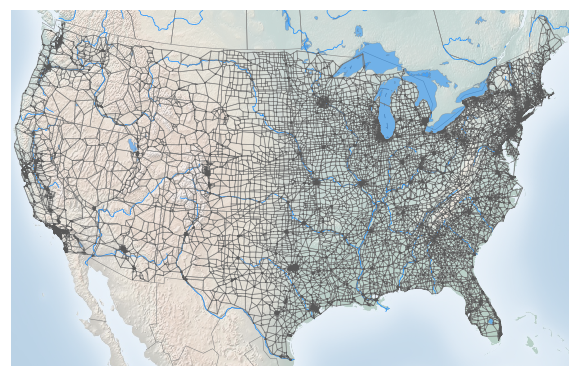

In [5]:
#nodecolor='#fc8d62'
#hicolor='#8da0cb'
#nodecolor='#a6d854'
#hicolor='#a6d854'
nodecolor1 = '#222222'
nodecolor2 = '#555555'
nodecolor3 = '#80b1d3'
edgecolor1 = '#fc8d62'
edgecolor2 = '#777777'
#ffffb3
#bebada
#fb8072
#80b1d3
#fdb462
#b3de69
import matplotlib.patheffects as pe
def drawusmap(cities=[]):
  f,axes = plt.subplots(1,1, figsize=(10,10))
  axes.set_rasterization_zorder(5)
  axes.xaxis.set_major_locator(plt.NullLocator())
  axes.yaxis.set_major_locator(plt.NullLocator())

  # setup Lambert Conformal basemap.
  # set resolution=None to skip processing of boundary datasets.
  # from https://github.com/matplotlib/basemap/blob/master/examples/fillstates.py
  m = Basemap(llcrnrlon=-119.25,llcrnrlat=19.75,urcrnrlon=-63.5,urcrnrlat=49,
              projection='lcc',lat_1=33,lat_2=45,lon_0=-95,epsg=2163)
  m.shadedrelief(alpha=0.5,ax=axes)
  xlims = axes.get_xlim()
  ylims = axes.get_ylim()
  #m.arcgisimage(service = 'World_Shaded_Relief', xpixels = 12000, alpha=0.5)
  m.drawcountries(ax=axes,color='grey',linewidth=0.5,zorder=0.5)
  m.drawstates(ax=axes,color='grey',linewidth=0.5,zorder=0.5)
  
  # handle Rivers
  m.readshapefile(riverslakes_shape,'myrivers',color='dodgerblue',
                  linewidth=0.75,zorder=0.75,drawbounds=True)

  # handle Lakes
  m.readshapefile(lakes_shape, 'mylakes',drawbounds=False)
  patches = []
  for info, shape in zip(m.mylakes_info, m.mylakes):
      patches.append( Polygon(np.array(shape), True) )
  axes.add_collection(PatchCollection(patches, 
                                      facecolor='dodgerblue',
                                      edgecolor='grey', 
                                      linewidths=0.5, zorder=0.75, alpha=0.5))

  # draw graph
  xp,yp = m(xy[:,0],xy[:,1])
  xyp = np.column_stack((xp,yp))
  for city in cities:
    label_city(xyp,city)
    
  #drawing = g.draw(xyp,nodesize=0.8,edgealpha=0.5,linewidth=0.5,
                   #nodealpha=0.5,axs=axes,nodecolor=nodecolor)
  #fc8d62  
  drawing = g.draw(xyp,nodesize=1.0,edgealpha=0.5,linewidth=0.9,
                   nodealpha=0.3,axs=axes,nodecolor=nodecolor2,edgecolor=edgecolor2)
  drawing.nodewidth(range(g._num_vertices), 0.2)
  stroke = [pe.withStroke(linewidth=0.5,
                                 foreground="#777777")]
  drawing.edge_collection.set_path_effects(stroke)
  #axes.set_xlim(np.min(xp)-100000,np.max(xp)+20000)
  axes.set_xlim(xlims)
  axes.set_ylim(np.min(yp)-50000,np.max(yp)+50000)
  
  return drawing, m, axes
#drawing,bm,ax = drawusmap(cities=["Seattle", "Los Angeles", "Denver", "Dallas", "Chicago", "New York", "Washington"])
drawing,bm,ax = drawusmap()
print(ax.get_xlim())
# test zooming
plt.savefig('usroads-simplify-network-dark.png', dpi=200,bbox_inches='tight',pad_inches = 0)

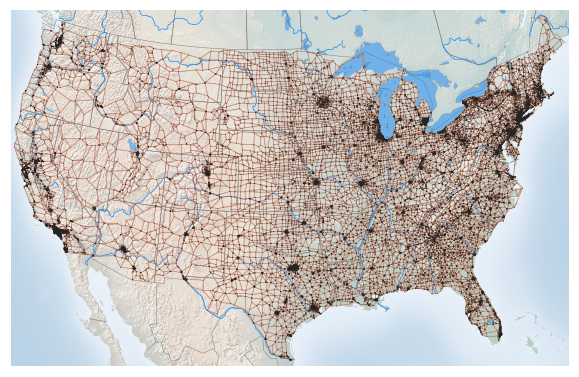

In [6]:
edgecolor2=edgecolor1
nodecolor2=nodecolor1
drawing,bm,ax = drawusmap()
plt.savefig('usroads-simplify-network-light.png', dpi=200,bbox_inches='tight',pad_inches = 0)

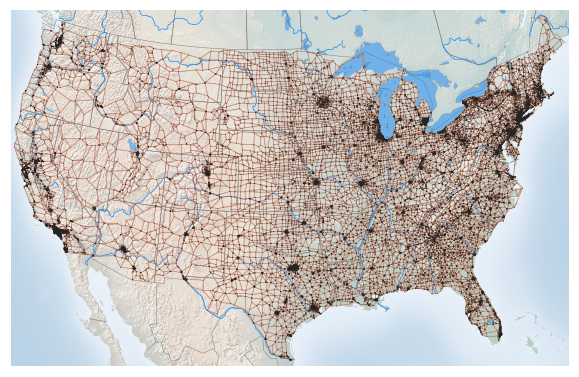

In [7]:
#edgecolor2='#E68310'
#nodecolor2='#3969AC'
drawing,bm,ax = drawusmap()
plt.savefig('usroads-simplify-network-bold.png', dpi=200,bbox_inches='tight',pad_inches = 0)

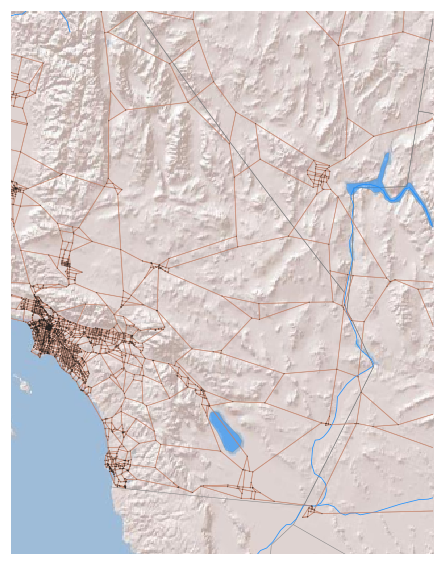

In [8]:
drawing,bm,ax = drawusmap()
# Test zooming 
ax.set_xlim([2*164014,5*164014])
ax.set_ylim([4*316652,6*316652])
drawing.nodesize(range(g._num_vertices), 1.5)
#m = Basemap(llcrnrlon=-119,llcrnrlat=40,urcrnrlon=-100,urcrnrlat=50,
#              projection='lcc',lat_1=33,lat_2=45,lon_0=-95, epsg=2163)
# need to add this for zooming. 
# this is the oroginal... we now have this image cached. 
bm.arcgisimage(xpixels=3000, alpha=0.75, axes=ax, zorder=0.5, service='World_Shaded_Relief')
plt.savefig('usroads-simplify-network-3.png', dpi=200,bbox_inches='tight',pad_inches = 0)

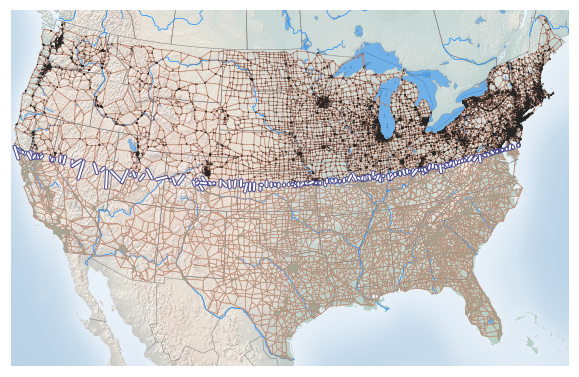

In [42]:
# Setup set highlighting 
# #fc8d62
"""
Original code -- new stuff puts the cut edges on top. 
def myhighlight(drawing,S,reverse=False,inputset=True):
  Sset = set(S)
  Sbar = set(range(drawing.G._num_vertices)) - Sset
  if reverse:
    S = list(Sbar)
    Sset,Sbar = Sbar,Sset
  if inputset:
    drawing.nodecolor(S, '#ff7f00', alpha=0.25)
  else:
    drawing.nodecolor(S, '#fb8072', alpha=0.25)
  drawing.nodecolor(list(Sbar), alpha=0.25)
  lws = np.asarray(drawing.edge_collection.get_linewidths())
  if len(lws) == 1:
    lws = np.array([lws[0]]*len(drawing.edge_mapping))
  for (i,j) in drawing.edge_mapping.keys():
    if (i in Sbar and j in Sbar) or (i in Sset and j in Sset):
      drawing.edgecolor(i,j,alpha=0.33)
    else:
      #drawing.edgecolor(i,j,c='crimson',alpha=1.0)
      drawing.edgecolor(i,j,c='#ffff33',alpha=1.0)
      idx = drawing.edge_mapping[(i,j)]
      lws[idx] = 1.55
  drawing.edge_collection.set_linewidths(lws)
"""

import matplotlib.collections 
import matplotlib.patheffects as pe
def myhighlight(drawing,S,reverse=False,inputset=True):
    Sset = set(S)
    Sbar = set(range(drawing.G._num_vertices)) - Sset
    old_edge_colors = drawing.edge_collection.get_color()
    old_edge_segs = drawing.edge_collection.get_segments()
    if reverse:
        S = list(Sbar)
        Sset,Sbar = Sbar,Sset
    if inputset:
        #drawing.nodecolor(S, '#ff7f00', alpha=0.25)
        #drawing.nodecolor(S, 'crimson', alpha=0.25)
        drawing.nodecolor(S, alpha=0.25)
    else:
        #drawing.nodecolor(S, '#fb8072', alpha=0.25)
        #drawing.nodecolor(S, '#7F3C8D', alpha=0.25)
        drawing.nodecolor(S, alpha=0.25)
    #drawing.nodecolor(list(Sbar), '#777777', alpha=0.25)
    drawing.nodecolor(list(Sbar), '#A5AA99', alpha=0.25)
    cut_edges = []
    for (i,j) in drawing.edge_mapping.keys():
        if (i in Sbar and j in Sbar) or (i in Sset and j in Sset):
            #drawing.edgecolor(i,j,alpha=0.33)
            pass
        else:
            #drawing.edgecolor(i,j,c='crimson',alpha=1.0)
            #drawing.edgecolor(i,j,c='#F2B701',alpha=0.0)
            drawing.edgecolor(i,j,c='#80BA5A',alpha=0.0)
            idx = drawing.edge_mapping[(i,j)]
            cut_edges.append(idx)
    cut_edge_segments = [old_edge_segs[i] for i in cut_edges]
    cut_edge_collection = matplotlib.collections.LineCollection(cut_edge_segments)
    cut_edge_collection.set_linewidths(2)
    cut_edge_collection.set_zorder(drawing.edge_collection.get_zorder()+1)
    #cut_edge_collection.set_edgecolor(c='#ffff33')
    #cut_edge_collection.set_edgecolor(c='crimson')
    cut_edge_collection.set_edgecolor(c='w')
    cut_edge_collection.set_capstyle('round')
    #cut_edge_collection.set_edgecolor(c='#80BA5A')
    stroke = [pe.withStroke(linewidth=4,capstyle="round",
                                 #foreground="#4b4b8f")]
                            #foreground="b")]
                            foreground="#4b4b8f")]
    drawing.cut_edge_collection = cut_edge_collection
    drawing.ax.add_collection(cut_edge_collection)
    cut_edge_collection.set_path_effects(stroke)
    drawing.ax._sci(cut_edge_collection)
  
S1 = [i for i in range(g._num_vertices) if xy[i,1] >= 39]  
drawing, bm, ax = drawusmap()
myhighlight(drawing, S1, inputset=False)  
plt.savefig('usroads-simplify-network-1.png', dpi=200,bbox_inches='tight',pad_inches=0)

0.7874352088211344

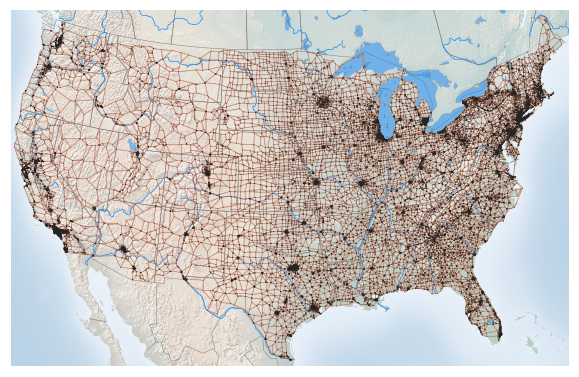

In [10]:
# we are going to setup code to cache the arcgis output
drawing, bm, ax = drawusmap()
bm.aspect

In [11]:
int(0.7874352088211344*7500)

5905

In [12]:
S1small = lgc.flow_clustering(g, S1, method='mqi')[0] # make a small set

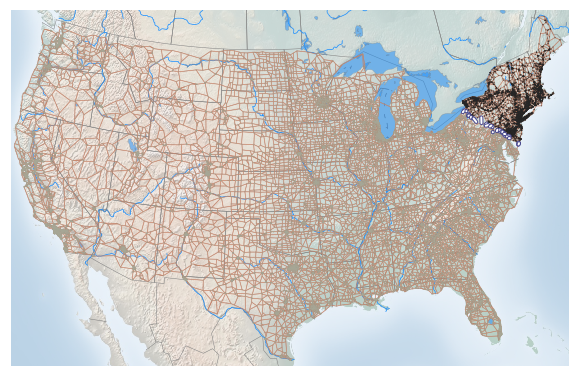

In [13]:
drawing, bm, ax = drawusmap()
myhighlight(drawing, S1small, inputset=False)  
plt.savefig('usroads-simplify-network-2.png', dpi=200,bbox_inches='tight',pad_inches=0)

## Try simple sets

In [14]:
import pprint 
from matplotlib.image import imread

# Return the smaller of Si or Si reversed
def simplify_set(g, Si):
  stats = g.set_scores(Si)
  if stats["voleff"] != stats["voltrue"]:
    # reverse 
    Si = list(set(range(drawing.G._num_vertices)) - set(Si))
  return Si

def find_boundary(g,Si):
    Si_s = np.array(list(set(range(g._num_vertices)).difference(Si)))
    Si,Si_s = set(Si),set(Si_s)
    boundary = set()
    for i in Si:
      for k in range(g.ai[i],g.ai[i+1]):
        if g.aj[k] in Si_s:
          boundary.add(i)
          boundary.add(g.aj[k])
    return list(boundary)
  
def bigger_graph(drawing):
  #drawing.nodes_collection.set_sizes(np.asarray(drawing.nodes_collection.get_sizes())*3)
  #drawing.edge_collection.set_linewidths(np.asarray(drawing.edge_collection.get_linewidths())*1.25)
  drawing.nodes_collection.set_sizes(np.asarray(drawing.nodes_collection.get_sizes())*5)
  drawing.edge_collection.set_linewidths(np.asarray(drawing.edge_collection.get_linewidths())*2)
  
  
def zoomfig_area(g, Si, bm, axes, offset=0.05):
    xlims = axes.get_xlim()
    ylims = axes.get_ylim()
    original_area = (xlims[1] - xlims[0])*(ylims[1]-ylims[0])
    
    xp, yp = bm(xy[:,0], xy[:,1]) # translate coordinates 
    #xp = xy[:,0] # we now translate these later incase we want to get a better arcgis image
    #yp = xy[:,1]
    Si = simplify_set(g, Si)
    ss = g.set_scores(Si)
    boundary = find_boundary(g,Si)
    
    xlim = (np.min(xp[boundary]),np.max(xp[boundary]))
    ylim = (np.min(yp[boundary]),np.max(yp[boundary]))
    
    local = False
    big = False
    if ss["voleff"] <= g.vol_G/5: # also include the set and show it 
        xlim = (min(np.min(xp[Si]), xlim[0]),max(np.max(xp[Si]), xlim[1]))
        ylim = (min(np.min(yp[Si]), ylim[0]),max(np.max(yp[Si]), ylim[1]))
        # and change the image to 
        #bm.arcgisimage(service = 'World_Shaded_Relief', xpixels = 2000, alpha=0.75)
        local = True
        new_area = (xlim[1]-xlim[0])*(ylim[1]-ylim[0])
        if new_area/original_area <= 0.2:
          big = True
        
    xlim = (max(xlim[0]-(xlim[1]-xlim[0])*offset,xlims[0]), min(xlim[1]+(xlim[1]-xlim[0])*offset,xlims[1]))
    ylim = (max(ylim[0]-(ylim[1]-ylim[0])*offset,ylims[0]), min(ylim[1]+(ylim[1]-ylim[0])*offset,ylims[1]))
    return xlim, ylim, local, big
  
def zoomfig(g,Si,bm,axes,drawing,offset=0.05):
    
    # get the initial figure size
    xlims = axes.get_xlim()
    ylims = axes.get_ylim()
    original_area = (xlims[1] - xlims[0])*(ylims[1]-ylims[0])
    
    xp, yp = bm(xy[:,0], xy[:,1]) # translate coordinates 
    #xp = xy[:,0] # we now translate these later incase we want to getxpi a better arcgis image
    #yp = xy[:,1]
    Si = simplify_set(g, Si)
    ss = g.set_scores(Si)
    boundary = find_boundary(g,Si)
    
    xlim = (np.min(xp[boundary]),np.max(xp[boundary]))
    ylim = (np.min(yp[boundary]),np.max(yp[boundary]))
    
    if ss["voleff"] <= g.vol_G/5: # also include the set and show it 
        xlim = (min(np.min(xp[Si]), xlim[0]),max(np.max(xp[Si]), xlim[1]))
        ylim = (min(np.min(yp[Si]), ylim[0]),max(np.max(yp[Si]), ylim[1]))
        # and change the image to 
        #bm.arcgisimage(service = 'World_Shaded_Relief', xpixels = 2000, alpha=0.75)
        #bm.arcgisimage(xpixels=5000, alpha=0.75, axes=axes, 
        #                zorder=0.5, service='World_Shaded_Relief')
        bm.imshow(imread("esri-shaded-relief-veryhires.png"),ax=axes,
                           origin='upper', alpha=0.75, zorder=0.5)
        new_area = (xlim[1]-xlim[0])*(ylim[1]-ylim[0])
        if new_area/original_area <= 0.2:
          bigger_graph(drawing)
        
        
    xlim = (max(xlim[0]-(xlim[1]-xlim[0])*offset,xlims[0]), min(xlim[1]+(xlim[1]-xlim[0])*offset,xlims[1]))
    ylim = (max(ylim[0]-(ylim[1]-ylim[0])*offset,ylims[0]), min(ylim[1]+(ylim[1]-ylim[0])*offset,ylims[1]))
    axes.set_xlim(xlim)
    axes.set_ylim(ylim)
    
def show_set_figures(g, S, name, zoom, inputset=True):
  pprint.pprint(g.set_scores(S))
  drawing, bm, ax = drawusmap()
  myhighlight(drawing, S, inputset=inputset)
  plt.savefig('%s.png'%(name), dpi=200,bbox_inches='tight',pad_inches = 0)
  
  if zoom: # figure out the new area, and save another marked image
    xlim,ylim,local,big = zoomfig_area(g, S, bm, ax)
    ax.add_patch(Polygon([(xlim[0],ylim[0]),(xlim[0],ylim[1]),(xlim[1],ylim[1]),(xlim[1],ylim[0])], 
                         closed=True, fc='none', edgecolor='k', lw=1.75, zorder=2))
    plt.savefig('%s-region.png'%(name), dpi=200,bbox_inches='tight',pad_inches = 0)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    if local:
      # to download the cached image, just save
      # http://server.arcgisonline.com/ArcGIS/rest/services/World_Shaded_Relief/MapServer/export?bbox=-2045969.4173062348,-2567274.0527822566,2546397.796126721,1048917.582910654&bboxSR=2163&imageSR=2163&size=5000,3937&dpi=96&format=png32&f=image
      # to esri-shared-relief-hires
      #bm.arcgisimage(xpixels=5000, alpha=0.75, axes=ax, 
      #                  zorder=0.5, service='World_Shaded_Relief')
      bm.imshow(imread("esri-shaded-relief-veryhires.png"),ax=ax,
                           origin='upper')
      if big:
        print("%s -- bigger graph"%(name))
        bigger_graph(drawing)
    #zoomfig(g, S, bm, ax, drawing)
    ax.get_figure().set_size_inches((5,5))
    plt.savefig('%s-zoom.png'%(name), dpi=400,bbox_inches='tight',pad_inches = 0)
  
def study_simple_set(g, Si, name, mqi=True, fi=True, sl01=True, sl05=True, sl1=True, zoom=True):
    Si = simplify_set(g, Si)
    result = {'input':Si}
    print("Input set: ")
    show_set_figures(g, Si, 'usroads-simplify-%s-set'%(name), zoom)
    print()
    print()
      
    
    if mqi:
      S = simplify_set(g, lgc.flow_clustering(g, Si, method='mqi')[0])
      result['mqi'] = S
      print("MQI set: ")
      show_set_figures(g, S, 'usroads-simplify-%s-mqi'%(name), zoom, inputset=False)
      print()
      print()
    
    if fi:
      S = simplify_set(g, lgc.flow_clustering(g, Si, method='sl', delta=0)[0])
      result['fi'] = S
      print("FI set: ")
      show_set_figures(g, S, 'usroads-simplify-%s-fi'%(name), zoom, inputset=False)
      print()
      print()
   
    if sl01:
      S = simplify_set(g, lgc.flow_clustering(g, Si, method='sl', delta=0.1)[0])
      result['sl01'] = S
      print("SL01 set: ")
      show_set_figures(g, S, 'usroads-simplify-%s-sl01'%(name), zoom, inputset=False)
      print()
      print()
      
    if sl05:
      S = simplify_set(g, lgc.flow_clustering(g, Si, method='sl', delta=0.5)[0])
      result['sl05'] = S
      print("SL05 set: ")
      show_set_figures(g, S, 'usroads-simplify-%s-sl05'%(name), zoom, inputset=False)
      print()
      print()
      
     
    if sl1:
      S = simplify_set(g, lgc.flow_clustering(g, Si, method='sl', delta=1)[0])
      result['sl1'] = S
      print("SL1 set: ")
      show_set_figures(g, S, 'usroads-simplify-%s-sl1'%(name), zoom, inputset=False)
      print()
      print()
      
    return result

{'cond': 0.0010654019314705982,
 'cut': 31.0,
 'edgeseff': 29066.0,
 'edgestrue': 29066.0,
 'isop': 0.0035673187571921747,
 'sizeeff': 8690,
 'sizetrue': 8690,
 'voleff': 29097.0,
 'voltrue': 29097.0}
figtest -- bigger graph


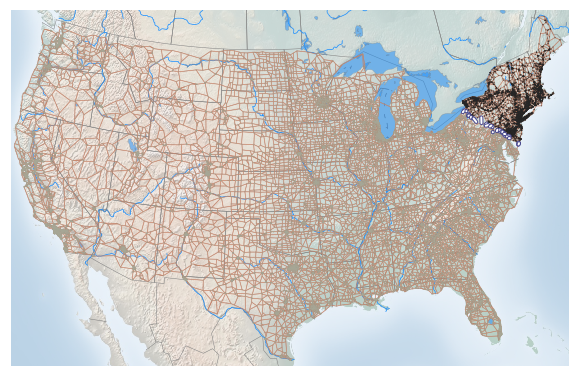

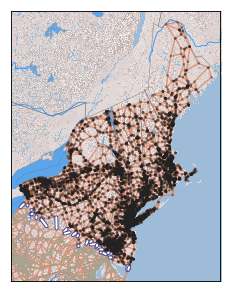

In [15]:
# this uses the horizontal S1 set above and is for testing subroutines
drawing, bm, ax = drawusmap()
myhighlight(drawing, S1small)
#zoomfig(g, S1small, bm, ax, drawing)
show_set_figures(g, S1small, "figtest", True)

Input set: 
{'cond': 0.0027304154215737975,
 'cut': 233.0,
 'edgeseff': 85102.0,
 'edgestrue': 85102.0,
 'isop': 0.009299912189670313,
 'sizeeff': 25054,
 'sizetrue': 25054,
 'voleff': 85335.0,
 'voltrue': 85335.0}


MQI set: 
{'cond': 0.001218026796589525,
 'cut': 12.0,
 'edgeseff': 9840.0,
 'edgestrue': 9840.0,
 'isop': 0.004343105320304018,
 'sizeeff': 2763,
 'sizetrue': 2763,
 'voleff': 9852.0,
 'voltrue': 9852.0}
usroads-simplify-horiz-mqi -- bigger graph




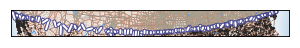

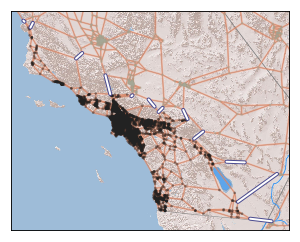

In [16]:
# This was used for testing some of the options 
Shoriz = [i for i in range(g._num_vertices) if xy[i,1] >= 39]
Shoriz_results = study_simple_set(g, Shoriz, 'horiz', fi=False, sl05=False, sl1=False, sl01=False)

Input set: 
{'cond': 0.0027304154215737975,
 'cut': 233.0,
 'edgeseff': 85102.0,
 'edgestrue': 85102.0,
 'isop': 0.009299912189670313,
 'sizeeff': 25054,
 'sizetrue': 25054,
 'voleff': 85335.0,
 'voltrue': 85335.0}


MQI set: 
{'cond': 0.001218026796589525,
 'cut': 12.0,
 'edgeseff': 9840.0,
 'edgestrue': 9840.0,
 'isop': 0.004343105320304018,
 'sizeeff': 2763,
 'sizetrue': 2763,
 'voleff': 9852.0,
 'voltrue': 9852.0}
usroads-simplify-horiz-mqi -- bigger graph


FI set: 
{'cond': 0.0008241211742305834,
 'cut': 29.0,
 'edgeseff': 35160.0,
 'edgestrue': 35160.0,
 'isop': 0.002769554006303123,
 'sizeeff': 10471,
 'sizetrue': 10471,
 'voleff': 35189.0,
 'voltrue': 35189.0}


SL01 set: 
{'cond': 0.0007803964413922273,
 'cut': 15.0,
 'edgeseff': 19206.0,
 'edgestrue': 19206.0,
 'isop': 0.002702702702702703,
 'sizeeff': 5550,
 'sizetrue': 5550,
 'voleff': 19221.0,
 'voltrue': 19221.0}
usroads-simplify-horiz-sl01 -- bigger graph


SL05 set: 
{'cond': 0.0007803964413922273,
 'cut': 15.0,
 'edge

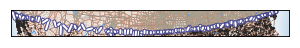

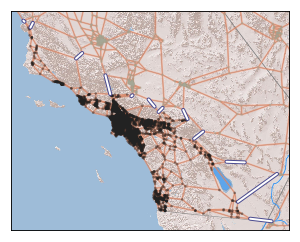

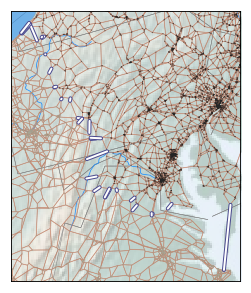

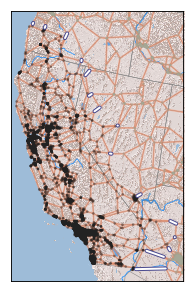

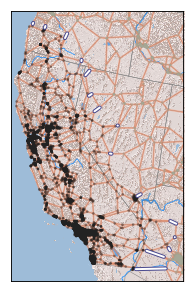

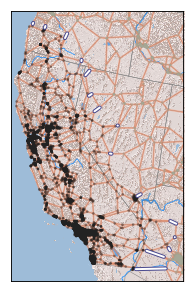

In [17]:
# This is the more comprehsnsive set 
Shoriz = [i for i in range(g._num_vertices) if xy[i,1] >= 39]
Shoriz_results = study_simple_set(g, Shoriz, 'horiz')

Input set: 
{'cond': 0.0015828598886345007,
 'cut': 112.0,
 'edgeseff': 70646.0,
 'edgestrue': 70646.0,
 'isop': 0.00535040366884823,
 'sizeeff': 20933,
 'sizetrue': 20933,
 'voleff': 70758.0,
 'voltrue': 70758.0}


MQI set: 
{'cond': 0.0005908855897776793,
 'cut': 16.0,
 'edgeseff': 27062.0,
 'edgestrue': 27062.0,
 'isop': 0.0020214782059380923,
 'sizeeff': 7915,
 'sizetrue': 7915,
 'voleff': 27078.0,
 'voltrue': 27078.0}
usroads-simplify-vert-mqi -- bigger graph


FI set: 
{'cond': 0.0005908855897776793,
 'cut': 16.0,
 'edgeseff': 27062.0,
 'edgestrue': 27062.0,
 'isop': 0.0020214782059380923,
 'sizeeff': 7915,
 'sizetrue': 7915,
 'voleff': 27078.0,
 'voltrue': 27078.0}
usroads-simplify-vert-fi -- bigger graph


SL01 set: 
{'cond': 0.0005908855897776793,
 'cut': 16.0,
 'edgeseff': 27062.0,
 'edgestrue': 27062.0,
 'isop': 0.0020214782059380923,
 'sizeeff': 7915,
 'sizetrue': 7915,
 'voleff': 27078.0,
 'voltrue': 27078.0}
usroads-simplify-vert-sl01 -- bigger graph


SL05 set: 
{'cond':

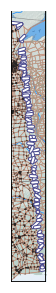

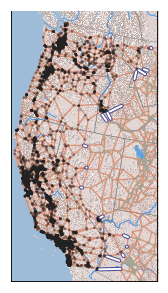

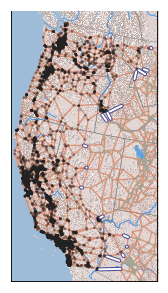

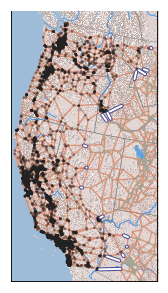

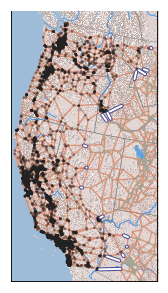

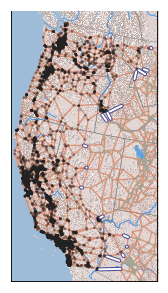

In [18]:
Svert = [i for i in range(g._num_vertices) if xy[i,0] >= -92]
Svert_results = study_simple_set(g, Svert, 'vert')

Input set: 
{'cond': 0.0018136850783182193,
 'cut': 132.0,
 'edgeseff': 72648.0,
 'edgestrue': 72648.0,
 'isop': 0.006124721603563474,
 'sizeeff': 21552,
 'sizetrue': 21552,
 'voleff': 72780.0,
 'voltrue': 72780.0}


MQI set: 
{'cond': 0.000823980679073732,
 'cut': 29.0,
 'edgeseff': 35166.0,
 'edgestrue': 35166.0,
 'isop': 0.002769025112193259,
 'sizeeff': 10473,
 'sizetrue': 10473,
 'voleff': 35195.0,
 'voltrue': 35195.0}


SL05 set: 
{'cond': 0.0004965595516776619,
 'cut': 42.0,
 'edgeseff': 84540.0,
 'edgestrue': 84540.0,
 'isop': 0.0016779864163004395,
 'sizeeff': 25030,
 'sizetrue': 25030,
 'voleff': 84582.0,
 'voltrue': 84582.0}




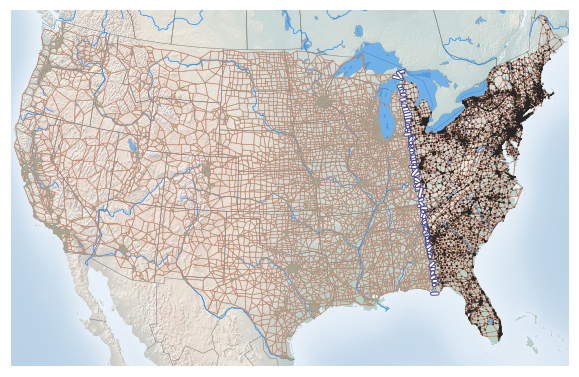

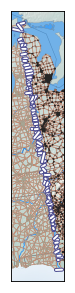

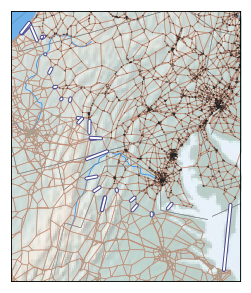

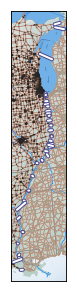

In [19]:
Svert85 = [i for i in range(g._num_vertices) if xy[i,0] >= -85]
drawing, bm, ax = drawusmap()
myhighlight(drawing, Svert85)  
g.set_scores(Svert85)
Svert_results = study_simple_set(g, Svert85, 'vert85', fi=False, sl05=True, sl1=False, sl01=False)

Input set: 
{'cond': 0.0018136850783182193,
 'cut': 132.0,
 'edgeseff': 72648.0,
 'edgestrue': 72648.0,
 'isop': 0.006124721603563474,
 'sizeeff': 21552,
 'sizetrue': 21552,
 'voleff': 72780.0,
 'voltrue': 72780.0}


MQI set: 
{'cond': 0.000823980679073732,
 'cut': 29.0,
 'edgeseff': 35166.0,
 'edgestrue': 35166.0,
 'isop': 0.002769025112193259,
 'sizeeff': 10473,
 'sizetrue': 10473,
 'voleff': 35195.0,
 'voltrue': 35195.0}


FI set: 
{'cond': 0.0004965595516776619,
 'cut': 42.0,
 'edgeseff': 84540.0,
 'edgestrue': 84540.0,
 'isop': 0.0016779864163004395,
 'sizeeff': 25030,
 'sizetrue': 25030,
 'voleff': 84582.0,
 'voltrue': 84582.0}


SL01 set: 
{'cond': 0.0004965595516776619,
 'cut': 42.0,
 'edgeseff': 84540.0,
 'edgestrue': 84540.0,
 'isop': 0.0016779864163004395,
 'sizeeff': 25030,
 'sizetrue': 25030,
 'voleff': 84582.0,
 'voltrue': 84582.0}


SL05 set: 
{'cond': 0.0004965595516776619,
 'cut': 42.0,
 'edgeseff': 84540.0,
 'edgestrue': 84540.0,
 'isop': 0.0016779864163004395,
 'size

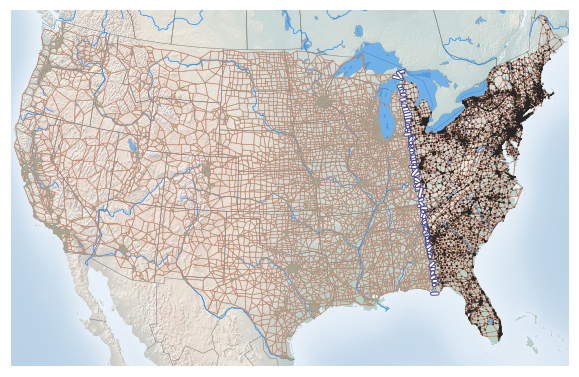

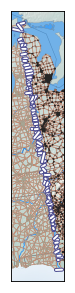

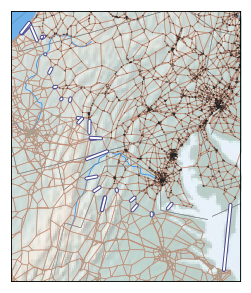

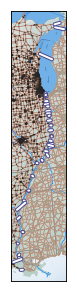

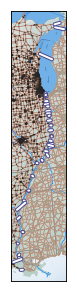

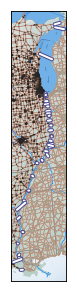

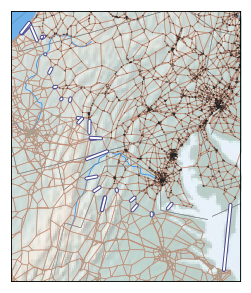

In [20]:
Svert85 = [i for i in range(g._num_vertices) if xy[i,0] >= -85]
drawing, bm, ax = drawusmap()
myhighlight(drawing, Svert85)  
g.set_scores(Svert85)
Svert_results = study_simple_set(g, Svert85, 'vert85')

Input set: 
{'cond': 0.0016322723563017372,
 'cut': 140.0,
 'edgeseff': 85630.0,
 'edgestrue': 85630.0,
 'isop': 0.005517023959646911,
 'sizeeff': 25376,
 'sizetrue': 25376,
 'voleff': 85770.0,
 'voltrue': 85770.0}


MQI set: 
{'cond': 0.0006502890173410405,
 'cut': 54.0,
 'edgeseff': 82986.0,
 'edgestrue': 82986.0,
 'isop': 0.0021964612568639414,
 'sizeeff': 24585,
 'sizetrue': 24585,
 'voleff': 83040.0,
 'voltrue': 83040.0}


FI set: 
{'cond': 0.0004983861780899943,
 'cut': 42.0,
 'edgeseff': 84230.0,
 'edgestrue': 84230.0,
 'isop': 0.001684244295624975,
 'sizeeff': 24937,
 'sizetrue': 24937,
 'voleff': 84272.0,
 'voltrue': 84272.0}


SL01 set: 
{'cond': 0.0004983861780899943,
 'cut': 42.0,
 'edgeseff': 84230.0,
 'edgestrue': 84230.0,
 'isop': 0.001684244295624975,
 'sizeeff': 24937,
 'sizetrue': 24937,
 'voleff': 84272.0,
 'voltrue': 84272.0}


SL05 set: 
{'cond': 0.0004972179472001894,
 'cut': 42.0,
 'edgeseff': 84428.0,
 'edgestrue': 84428.0,
 'isop': 0.0016804032967912298,
 'size

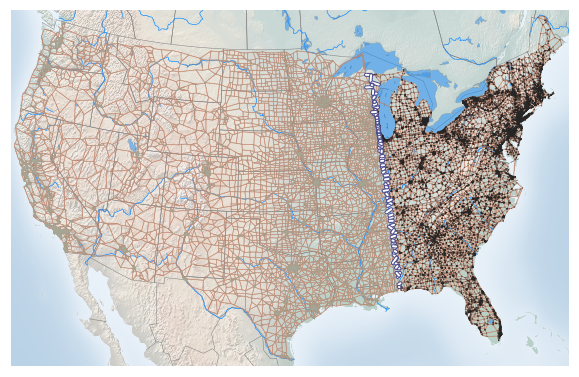

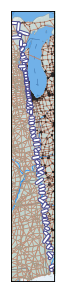

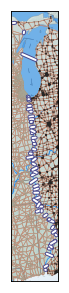

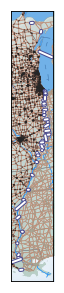

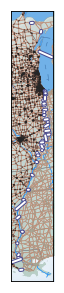

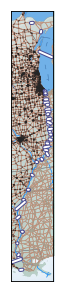

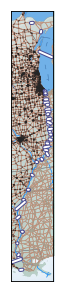

In [21]:
Svert88 = [i for i in range(g._num_vertices) if xy[i,0] >= -88]
drawing, bm, ax = drawusmap()
myhighlight(drawing, Svert88)  
g.set_scores(Svert88)
Svert88_results = study_simple_set(g, Svert88, 'vert88')

Input set: 
{'cond': 0.008341532275313342,
 'cut': 195.0,
 'edgeseff': 23182.0,
 'edgestrue': 23182.0,
 'isop': 0.02792896018332856,
 'sizeeff': 6982,
 'sizetrue': 6982,
 'voleff': 23377.0,
 'voltrue': 23377.0}


MQI set: 
{'cond': 0.005002779321845469,
 'cut': 9.0,
 'edgeseff': 1790.0,
 'edgestrue': 1790.0,
 'isop': 0.017786561264822136,
 'sizeeff': 506,
 'sizetrue': 506,
 'voleff': 1799.0,
 'voltrue': 1799.0}
usroads-simplify-center-mqi -- bigger graph


FI set: 
{'cond': 0.0004987886561208494,
 'cut': 42.0,
 'edgeseff': 84162.0,
 'edgestrue': 84162.0,
 'isop': 0.0016856638304703804,
 'sizeeff': 24916,
 'sizetrue': 24916,
 'voleff': 84204.0,
 'voltrue': 84204.0}


SL01 set: 
{'cond': 0.0037951377146507345,
 'cut': 101.0,
 'edgeseff': 26512.0,
 'edgestrue': 26512.0,
 'isop': 0.012718801158544265,
 'sizeeff': 7941,
 'sizetrue': 7941,
 'voleff': 26613.0,
 'voltrue': 26613.0}


SL05 set: 
{'cond': 0.0037479780644652226,
 'cut': 95.0,
 'edgeseff': 25252.0,
 'edgestrue': 25252.0,
 'isop': 

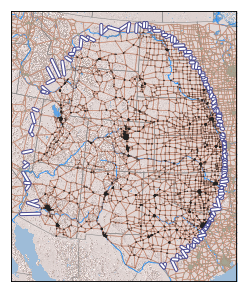

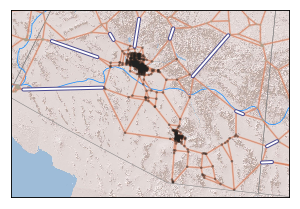

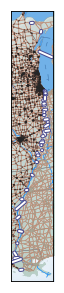

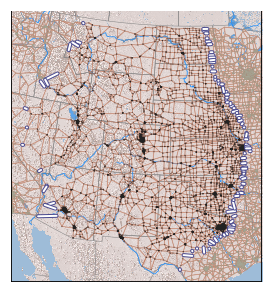

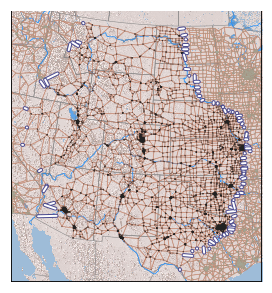

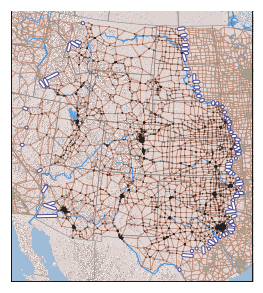

In [22]:
Scenter = [i for i in range(g._num_vertices) if np.sqrt((xy[i,1] - 38.742475)**2 + (xy[i,0]--104.848444)**2) <= 10]
Scenter_results = study_simple_set(g, Scenter, 'center')

## Identify captials and align

In [23]:
capitals = """Name: Alabama

Capital Name: Montgomery

Capital Latitude: 32.361538

Capital Longitude: -86.279118

Name: Arizona

Capital Name: Phoenix

Capital Latitude: 33.448457

Capital Longitude: -112.073844

Name: Arkansas

Capital Name: Little Rock

Capital Latitude: 34.736009

Capital Longitude: -92.331122

Name: California

Capital Name: Sacramento

Capital Latitude: 38.555605

Capital Longitude: -121.468926

Name: Colorado

Capital Name: Denver

Capital Latitude: 39.7391667

Capital Longitude: -104.984167

Name: Connecticut

Capital Name: Hartford

Capital Latitude: 41.767

Capital Longitude: -72.677

Name: Delaware

Capital Name: Dover

Capital Latitude: 39.161921

Capital Longitude: -75.526755

Name: Florida

Capital Name: Tallahassee

Capital Latitude: 30.4518

Capital Longitude: -84.27277

Name: Georgia

Capital Name: Atlanta

Capital Latitude: 33.76

Capital Longitude: -84.39

Name: Idaho

Capital Name: Boise

Capital Latitude: 43.613739

Capital Longitude: -116.237651

Name: Illinois

Capital Name: Springfield

Capital Latitude: 39.783250

Capital Longitude: -89.650373

Name: Indiana

Capital Name: Indianapolis

Capital Latitude: 39.790942

Capital Longitude: -86.147685

Name: Iowa

Capital Name: Des Moines

Capital Latitude: 41.590939

Capital Longitude: -93.620866

Name: Kansas

Capital Name: Topeka

Capital Latitude: 39.04

Capital Longitude: -95.69

Name: Kentucky

Capital Name: Frankfort

Capital Latitude: 38.197274

Capital Longitude: -84.86311

Name: Louisiana

Capital Name: Baton Rouge

Capital Latitude: 30.45809

Capital Longitude: -91.140229

Name: Maine

Capital Name: Augusta

Capital Latitude: 44.323535

Capital Longitude: -69.765261

Name: Maryland

Capital Name: Annapolis

Capital Latitude: 38.972945

Capital Longitude: -76.501157

Name: Massachusetts

Capital Name: Boston

Capital Latitude: 42.2352

Capital Longitude: -71.0275

Name: Michigan

Capital Name: Lansing

Capital Latitude: 42.7335

Capital Longitude: -84.5467

Name: Minnesota

Capital Name: Saint Paul

Capital Latitude: 44.95

Capital Longitude: -93.094

Name: Mississippi

Capital Name: Jackson

Capital Latitude: 32.320

Capital Longitude: -90.207

Name: Missouri

Capital Name: Jefferson City

Capital Latitude: 38.572954

Capital Longitude: -92.189283

Name: Montana

Capital Name: Helana

Capital Latitude: 46.595805

Capital Longitude: -112.027031

Name: Nebraska

Capital Name: Lincoln

Capital Latitude: 40.809868

Capital Longitude: -96.675345

Name: Nevada

Capital Name: Carson City

Capital Latitude: 39.160949

Capital Longitude: -119.753877

Name: New Hampshire

Capital Name: Concord

Capital Latitude: 43.220093

Capital Longitude: -71.549127

Name: New Jersey

Capital Name: Trenton

Capital Latitude: 40.221741

Capital Longitude: -74.756138

Name: New Mexico

Capital Name: Santa Fe

Capital Latitude: 35.667231

Capital Longitude: -105.964575

Name: New York

Capital Name: Albany

Capital Latitude: 42.659829

Capital Longitude: -73.781339

Name: North Carolina

Capital Name: Raleigh

Capital Latitude: 35.771

Capital Longitude: -78.638

Name: North Dakota

Capital Name: Bismarck

Capital Latitude: 48.813343

Capital Longitude: -100.779004

Name: Ohio

Capital Name: Columbus

Capital Latitude: 39.962245

Capital Longitude: -83.000647

Name: Oklahoma

Capital Name: Oklahoma City

Capital Latitude: 35.482309

Capital Longitude: -97.534994

Name: Oregon

Capital Name: Salem

Capital Latitude: 44.931109

Capital Longitude: -123.029159

Name: Pennsylvania

Capital Name: Harrisburg

Capital Latitude: 40.269789

Capital Longitude: -76.875613

Name: Rhode Island

Capital Name: Providence

Capital Latitude: 41.82355

Capital Longitude: -71.422132

Name: South Carolina

Capital Name: Columbia

Capital Latitude: 34.000

Capital Longitude: -81.035

Name: South Dakota

Capital Name: Pierre

Capital Latitude: 44.367966

Capital Longitude: -100.336378

Name: Tennessee

Capital Name: Nashville

Capital Latitude: 36.165

Capital Longitude: -86.784

Name: Texas

Capital Name: Austin

Capital Latitude: 30.266667

Capital Longitude: -97.75

Name: Utah

Capital Name: Salt Lake City

Capital Latitude: 40.7547

Capital Longitude: -111.892622

Name: Vermont

Capital Name: Montpelier

Capital Latitude: 44.26639

Capital Longitude: -72.57194

Name: Virginia

Capital Name: Richmond

Capital Latitude: 37.54

Capital Longitude: -77.46

Name: Washington

Capital Name: Olympia

Capital Latitude: 47.042418

Capital Longitude: -122.893077

Name: West Virginia

Capital Name: Charleston

Capital Latitude: 38.349497

Capital Longitude: -81.633294

Name: Wisconsin

Capital Name: Madison

Capital Latitude: 43.074722

Capital Longitude: -89.384444

Name: Wyoming

Capital Name: Cheyenne

Capital Latitude: 41.145548

Capital Longitude: -104.802042""".split("\n\n")
caps=[]
for i in range(0,len(capitals),4):
  xc = float(capitals[i+2].split(": ")[1])
  yc = float(capitals[i+3].split(": ")[1])
  xyc = np.array([yc,xc])
  dists = np.sum((xy - xyc)**2,axis=1) 
  node = np.sum((xy - xyc)**2,axis=1).argmin()
  caps.append((capitals[i].split(": ")[1], node))
  
def random_walk(g,start,k):
    curr_node = start
    iters = 0
    trajectory = [curr_node]
    while iters < k:
        neighs = g.aj[g.ai[curr_node]:g.ai[curr_node+1]]
        curr_node = np.random.choice(neighs)
        trajectory.append(curr_node)
        iters += 1
    return trajectory  
  
def cap_random_walk_sets(k=1000):
  # Form random walks   
  np.random.seed(1)
  caprw = set()
  for cap in caps:
    capnode = cap[1] 
    S = random_walk(g,capnode,k)
    caprw.update(S)
    #print(cap[0], " cond=", capcond)
  return list(caprw)    
caprws = {}
caprws[1000] = cap_random_walk_sets(1000)
caprws[500] = cap_random_walk_sets(500)
caprws[250] = cap_random_walk_sets(250)
caprws[100] = cap_random_walk_sets(100)

# Form shortest path sets
import networkx as nx
nG = nx.from_scipy_sparse_matrix(g.adjacency_matrix)
spsets = set()
for cap in caps:
  capnode = cap[1] 
  for cap2 in caps:
    capnode2 = cap2[1]
    if capnode2 > capnode:
      spsets.update(nx.shortest_path(nG, source=capnode, target=capnode2))
spsets = list(spsets)


Input set: 
{'cond': 0.33063619792824434,
 'cut': 7437.0,
 'edgeseff': 15056.0,
 'edgestrue': 15056.0,
 'isop': 1.135766646304215,
 'sizeeff': 6548,
 'sizetrue': 6548,
 'voleff': 22493.0,
 'voltrue': 22493.0}


MQI set: 
{'cond': 0.15294117647058825,
 'cut': 13.0,
 'edgeseff': 72.0,
 'edgestrue': 72.0,
 'isop': 0.48148148148148145,
 'sizeeff': 27,
 'sizetrue': 27,
 'voleff': 85.0,
 'voltrue': 85.0}
usroads-simplify-sp-mqi -- bigger graph


FI set: 
{'cond': 0.0031970127113225403,
 'cut': 250.0,
 'edgeseff': 77948.0,
 'edgestrue': 77948.0,
 'isop': 0.010665074015613668,
 'sizeeff': 23441,
 'sizetrue': 23441,
 'voleff': 78198.0,
 'voltrue': 78198.0}


SL01 set: 
{'cond': 0.006102500405033213,
 'cut': 226.0,
 'edgeseff': 36808.0,
 'edgestrue': 36808.0,
 'isop': 0.020263606204608625,
 'sizeeff': 11153,
 'sizetrue': 11153,
 'voleff': 37034.0,
 'voltrue': 37034.0}


SL05 set: 
{'cond': 0.06467661691542288,
 'cut': 26.0,
 'edgeseff': 376.0,
 'edgestrue': 376.0,
 'isop': 0.19696969696969696,
 

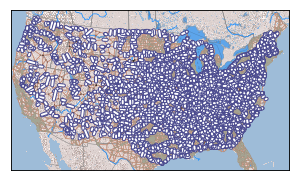

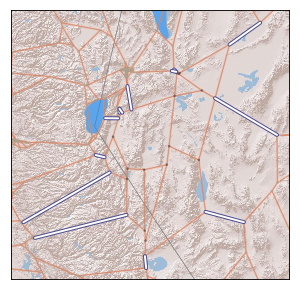

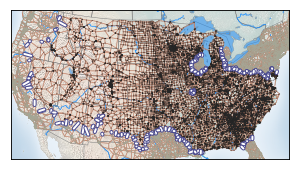

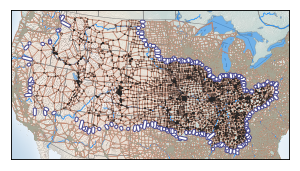

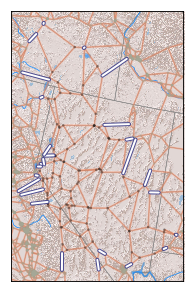

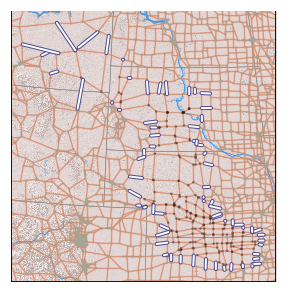

In [24]:
spsets_results = study_simple_set(g, spsets, 'sp')

Input set: 
{'cond': 0.1416730621642364,
 'cut': 5538.0,
 'edgeseff': 33552.0,
 'edgestrue': 33552.0,
 'isop': 0.4808961444946162,
 'sizeeff': 11516,
 'sizetrue': 11516,
 'voleff': 39090.0,
 'voltrue': 39090.0}


MQI set: 
{'cond': 0.030927835051546393,
 'cut': 6.0,
 'edgeseff': 188.0,
 'edgestrue': 188.0,
 'isop': 0.10909090909090909,
 'sizeeff': 55,
 'sizetrue': 55,
 'voleff': 194.0,
 'voltrue': 194.0}
usroads-simplify-rw1000-mqi -- bigger graph


FI set: 
{'cond': 0.0029582929194956354,
 'cut': 244.0,
 'edgeseff': 82236.0,
 'edgestrue': 82236.0,
 'isop': 0.009927173603482648,
 'sizeeff': 24579,
 'sizetrue': 24579,
 'voleff': 82480.0,
 'voltrue': 82480.0}


SL01 set: 
{'cond': 0.0028376844494892167,
 'cut': 30.0,
 'edgeseff': 10542.0,
 'edgestrue': 10542.0,
 'isop': 0.009351620947630923,
 'sizeeff': 3208,
 'sizetrue': 3208,
 'voleff': 10572.0,
 'voltrue': 10572.0}
usroads-simplify-rw1000-sl01 -- bigger graph


SL05 set: 
{'cond': 0.007451564828614009,
 'cut': 10.0,
 'edgeseff': 1332.

/home/dgleich/.local/lib/python3.5/site-packages/matplotlib/pyplot.py:537: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



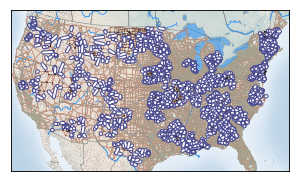

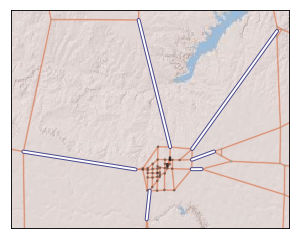

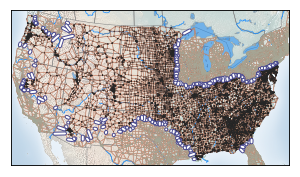

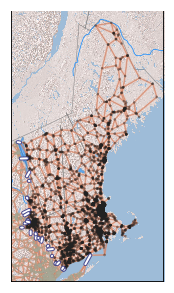

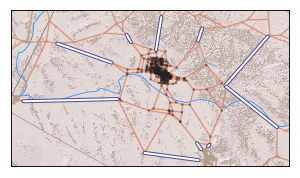

...

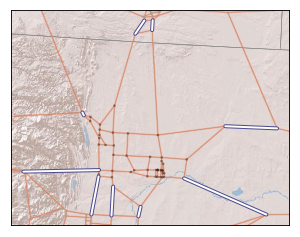

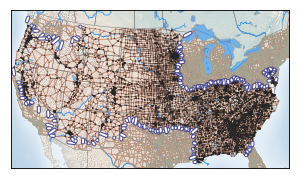

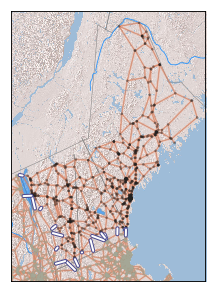

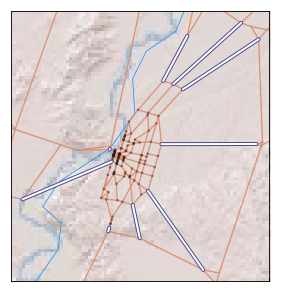

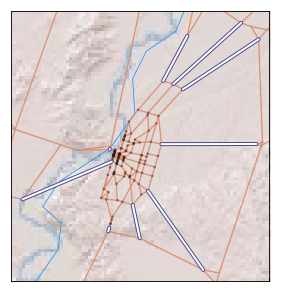

In [25]:
caprws_results = {}
for rwlen in caprws:
  caprws_results[rwlen] = study_simple_set(g, caprws[rwlen], 'rw%i'%(rwlen))

Try a random walk around Indianapolis. 

In [26]:
def cap_study(node, rwlen, nwalks, name, offset=0.75):
  np.random.seed(0)
  Scap = set()
  for i in range(nwalks):
    Scap.update(random_walk(g, node, rwlen))
  Scap = list(Scap)  
  drawing, bm, ax = drawusmap()
  myhighlight(drawing, Scap)
  zoomfig(g, Scap, bm, ax, drawing, offset=offset)
  bigger_graph(drawing)
  pprint.pprint(g.set_scores(Scap))
  plt.savefig('usroads-simplify-rwcap-%s.png'%(name), dpi=200,bbox_inches='tight',pad_inches=0)
  
  for delta in [1, 0.5, 0.1]:
    Sfi = lgc.flow_clustering(g, Scap, method="sl", delta=delta)[0]
    drawing, bm, ax = drawusmap()
    myhighlight(drawing, Sfi)
    zoomfig(g, Sfi, bm, ax, drawing, offset=offset)
    bigger_graph(drawing)
    print("Delta = %f"%(delta))
    pprint.pprint(g.set_scores(Sfi))
    plt.savefig('usroads-simplify-rwcap-%s-sl%s.png'%(name,("%.1f"%(delta)).replace(".","")), 
                    dpi=200,bbox_inches='tight',pad_inches=0)

In [27]:
# Indiana
#cap_study(caps[11][1], 35, 100, "ind") # this one is pretty good
#cap_study(caps[11][1], 40, 120, "ind") # this is probably better
#cap_study(caps[11][1], 60, 200, "ind") # see final below 

In [28]:
# Virginia
#cap_study(caps[43][1], 50, 150, "vir") # pretty good... 
#cap_study(caps[43][1], 60, 200, "vir") # these are GREAT! we are going to use these... 
# see the final study below. 

{'cond': 0.08333333333333333,
 'cut': 112.0,
 'edgeseff': 1232.0,
 'edgestrue': 1232.0,
 'isop': 0.28498727735368956,
 'sizeeff': 393,
 'sizetrue': 393,
 'voleff': 1344.0,
 'voltrue': 1344.0}
Delta = inf
{'cond': 0.028985507246376812,
 'cut': 24.0,
 'edgeseff': 804.0,
 'edgestrue': 804.0,
 'isop': 0.1,
 'sizeeff': 240,
 'sizetrue': 240,
 'voleff': 828.0,
 'voltrue': 828.0}
Delta = 1.500000
{'cond': 0.02155576382380506,
 'cut': 23.0,
 'edgeseff': 1044.0,
 'edgestrue': 1044.0,
 'isop': 0.07371794871794872,
 'sizeeff': 312,
 'sizetrue': 312,
 'voleff': 1067.0,
 'voltrue': 1067.0}
Delta = 1.000000
{'cond': 0.019801980198019802,
 'cut': 24.0,
 'edgeseff': 1188.0,
 'edgestrue': 1188.0,
 'isop': 0.06722689075630252,
 'sizeeff': 357,
 'sizetrue': 357,
 'voleff': 1212.0,
 'voltrue': 1212.0}
Delta = 0.500000
{'cond': 0.019801980198019802,
 'cut': 24.0,
 'edgeseff': 1188.0,
 'edgestrue': 1188.0,
 'isop': 0.06722689075630252,
 'sizeeff': 357,
 'sizetrue': 357,
 'voleff': 1212.0,
 'voltrue': 1212.0

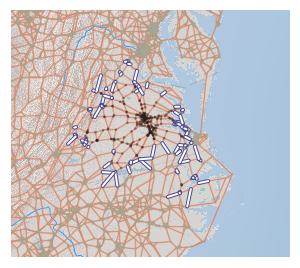

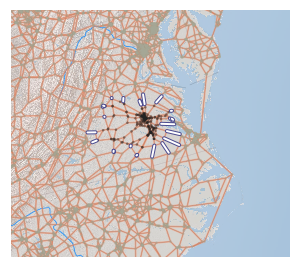

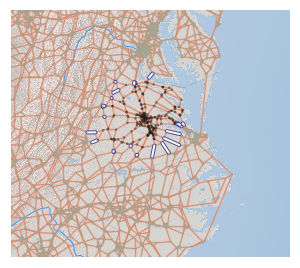

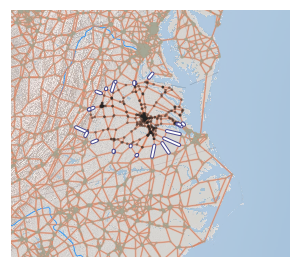

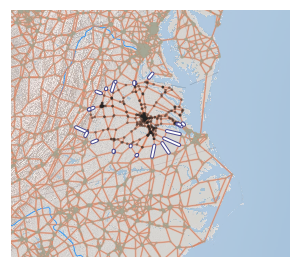

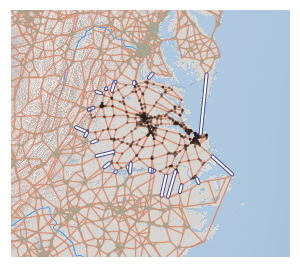

In [44]:
# Finalize the Virginia figs
def cap_study_final(node, rwlen, nwalks, name, offset=0.35):
  np.random.seed(0)
  Scap = set()
  for i in range(nwalks):
    Scap.update(random_walk(g, node, rwlen))
  Scap = list(Scap)  
  
  # it's fast enough just to compute these... 
  Sall = set(Scap)
  for delta in [float('inf'), 1.5, 1, 0.5, 0.1]:
    if delta == float('inf'):
      Sall.update(lgc.flow_clustering(g, Scap, method="mqi")[0])
    else:
      Sall.update(lgc.flow_clustering(g, Scap, method="sl", delta=delta)[0])
  Sall = list(Sall)
  
  drawing, bm, ax = drawusmap()
  myhighlight(drawing, Scap)
  #drawing.cut_edge_collection.set_linewidths(np.asarray(drawing.cut_edge_collection.get_linewidths())*2)
  
  zoomfig(g, Sall, bm, ax, drawing, offset=offset)
  #bigger_graph(drawing)
  pprint.pprint(g.set_scores(Scap))
  ax.get_figure().set_size_inches((5,5))
  plt.savefig('usroads-simplify-rwcap-%s.png'%(name), dpi=400,bbox_inches='tight',pad_inches=0)
  
  for delta in [float('inf'), 1.5, 1, 0.5, 0.1]:
    if delta == float('inf'):
      Sfi = lgc.flow_clustering(g, Scap, method="mqi")[0]
    else:
      Sfi = lgc.flow_clustering(g, Scap, method="sl", delta=delta)[0]
    drawing, bm, ax = drawusmap()
    myhighlight(drawing, Sfi)
    zoomfig(g, Sall, bm, ax, drawing, offset=offset)
    #bigger_graph(drawing)
    print("Delta = %f"%(delta))
    pprint.pprint(g.set_scores(Sfi))
    ax.get_figure().set_size_inches((5,5))
    plt.savefig('usroads-simplify-rwcap-%s-sl%s.png'%(name,("%.1f"%(delta)).replace(".","")), 
                    dpi=400,bbox_inches='tight',pad_inches=0)
cap_study_final(caps[43][1], 60, 200, "vir")  

{'cond': 0.05040650406504065,
 'cut': 62.0,
 'edgeseff': 1168.0,
 'edgestrue': 1168.0,
 'isop': 0.17563739376770537,
 'sizeeff': 353,
 'sizetrue': 353,
 'voleff': 1230.0,
 'voltrue': 1230.0}
Delta = inf
{'cond': 0.020618556701030927,
 'cut': 16.0,
 'edgeseff': 760.0,
 'edgestrue': 760.0,
 'isop': 0.07272727272727272,
 'sizeeff': 220,
 'sizetrue': 220,
 'voleff': 776.0,
 'voltrue': 776.0}
Delta = 1.500000
{'cond': 0.014989293361884369,
 'cut': 14.0,
 'edgeseff': 920.0,
 'edgestrue': 920.0,
 'isop': 0.052830188679245285,
 'sizeeff': 265,
 'sizetrue': 265,
 'voleff': 934.0,
 'voltrue': 934.0}
Delta = 1.000000
{'cond': 0.013251783893985729,
 'cut': 13.0,
 'edgeseff': 968.0,
 'edgestrue': 968.0,
 'isop': 0.04642857142857143,
 'sizeeff': 280,
 'sizetrue': 280,
 'voleff': 981.0,
 'voltrue': 981.0}
Delta = 0.500000
{'cond': 0.013251783893985729,
 'cut': 13.0,
 'edgeseff': 968.0,
 'edgestrue': 968.0,
 'isop': 0.04642857142857143,
 'sizeeff': 280,
 'sizetrue': 280,
 'voleff': 981.0,
 'voltrue': 

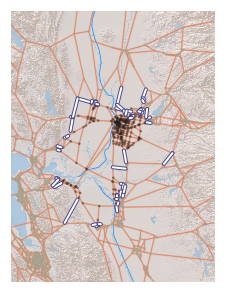

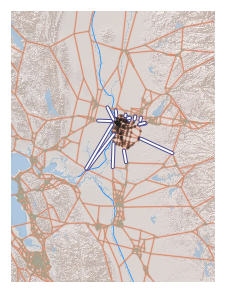

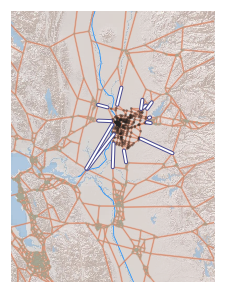

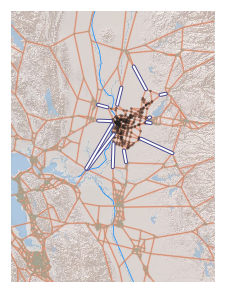

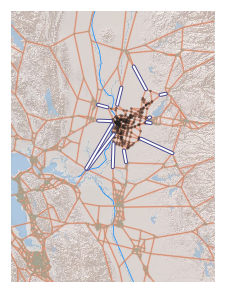

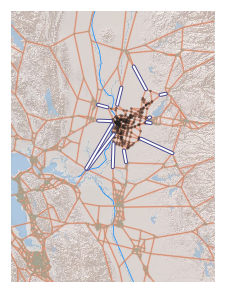

In [45]:
# California
# cap_study(caps[3][1], 35, 100, "calif") this one is okay ... 
#cap_study(caps[3][1], 40, 120, "calif")
#cap_study(caps[3][1], 60, 200, "calif")
cap_study_final(caps[3][1], 60, 200, "calif")  

{'cond': 0.09906542056074766,
 'cut': 159.0,
 'edgeseff': 1446.0,
 'edgestrue': 1446.0,
 'isop': 0.3479212253829322,
 'sizeeff': 457,
 'sizetrue': 457,
 'voleff': 1605.0,
 'voltrue': 1605.0}
Delta = inf
{'cond': 0.03745743473325766,
 'cut': 33.0,
 'edgeseff': 848.0,
 'edgestrue': 848.0,
 'isop': 0.13253012048192772,
 'sizeeff': 249,
 'sizetrue': 249,
 'voleff': 881.0,
 'voltrue': 881.0}
Delta = 1.500000
{'cond': 0.03145695364238411,
 'cut': 38.0,
 'edgeseff': 1170.0,
 'edgestrue': 1170.0,
 'isop': 0.11014492753623188,
 'sizeeff': 345,
 'sizetrue': 345,
 'voleff': 1208.0,
 'voltrue': 1208.0}
Delta = 1.000000
{'cond': 0.029814665592264304,
 'cut': 37.0,
 'edgeseff': 1204.0,
 'edgestrue': 1204.0,
 'isop': 0.10422535211267606,
 'sizeeff': 355,
 'sizetrue': 355,
 'voleff': 1241.0,
 'voltrue': 1241.0}
Delta = 0.500000
{'cond': 0.028136882129277566,
 'cut': 37.0,
 'edgeseff': 1278.0,
 'edgestrue': 1278.0,
 'isop': 0.09814323607427056,
 'sizeeff': 377,
 'sizetrue': 377,
 'voleff': 1315.0,
 'vo

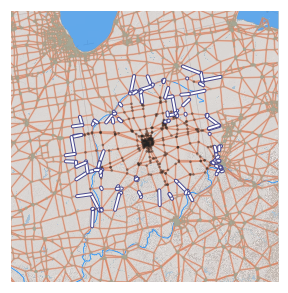

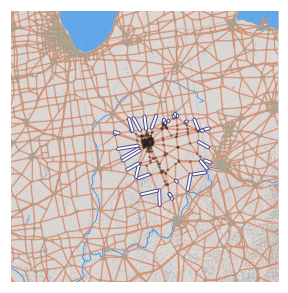

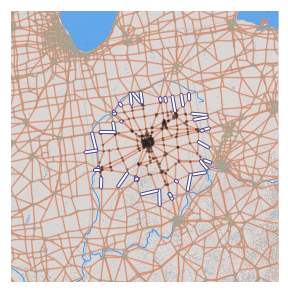

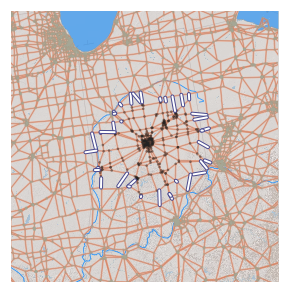

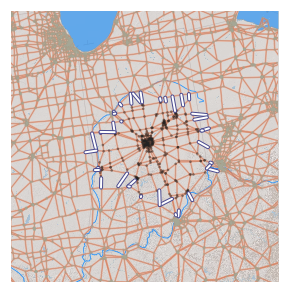

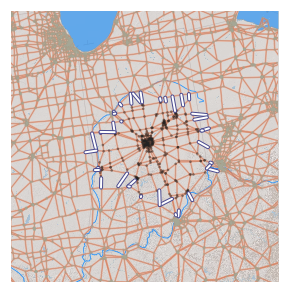

In [46]:
# make the set of Indiana figures
cap_study_final(caps[11][1], 60, 200, "ind")  

## These are extra codes below. 

{'cond': 0.08704061895551257,
 'cut': 45.0,
 'edgeseff': 472.0,
 'edgestrue': 472.0,
 'isop': 0.3125,
 'sizeeff': 144,
 'sizetrue': 144,
 'voleff': 517.0,
 'voltrue': 517.0}

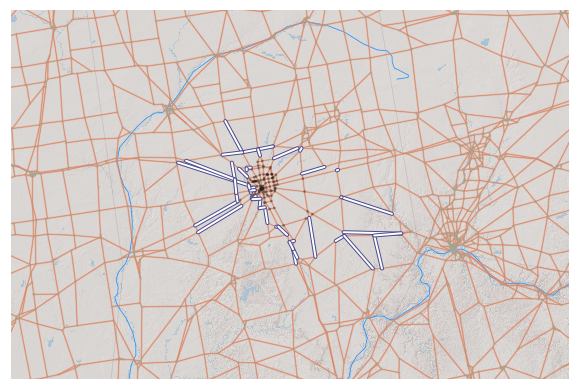

In [47]:
cap_indiana = caps[11][1]
np.random.seed(0)
Scap = set()
for i in range(100):
    Scap.update(random_walk(g, cap_indiana, 20))
Scap = list(Scap)  
drawing, bm, ax = drawusmap()
myhighlight(drawing, Scap)
zoomfig(g, Scap, bm, ax, drawing, offset=0.75)
g.set_scores(Scap)

In [48]:
Sfi = lgc.flow_clustering(g, Scap, method="sl", delta=0.0)[0]
#drawing, bm, ax = drawusmap()
#myhighlight(drawing, Sfi)
#zoomfig(g, Sfi, bm, ax, drawing, offset=0.75)
g.set_scores(Sfi)

{'cond': 0.03853211009174312,
 'cut': 21.0,
 'edgeseff': 524.0,
 'edgestrue': 524.0,
 'isop': 0.13725490196078433,
 'sizeeff': 153,
 'sizetrue': 153,
 'voleff': 545.0,
 'voltrue': 545.0}

In [49]:
## Try the same thing for Capital of Virginia and Capital of California... 


{'cond': 0.11004784688995216,
 'cut': 46.0,
 'edgeseff': 372.0,
 'edgestrue': 372.0,
 'isop': 0.39655172413793105,
 'sizeeff': 116,
 'sizetrue': 116,
 'voleff': 418.0,
 'voltrue': 418.0}

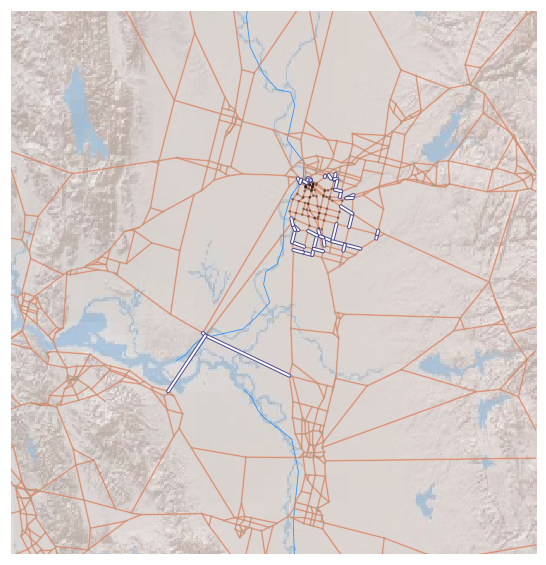

In [50]:
cap_calif = caps[3][1]
Scap = set()
for i in range(100):
    Scap.update(random_walk(g, cap_calif, 20))
Scap = list(Scap)  
drawing, bm, ax = drawusmap()
myhighlight(drawing, Scap)
zoomfig(g, Scap, bm, ax, drawing, offset=0.75)
#bigger_graph(
#plt.savefig('usroads-simplify-network-1.png', dpi=200,bbox_inches='tight',pad_inches=0)
g.set_scores(Scap)

{'cond': 0.01330603889457523,
 'cut': 13.0,
 'edgeseff': 964.0,
 'edgestrue': 964.0,
 'isop': 0.04659498207885305,
 'sizeeff': 279,
 'sizetrue': 279,
 'voleff': 977.0,
 'voltrue': 977.0}

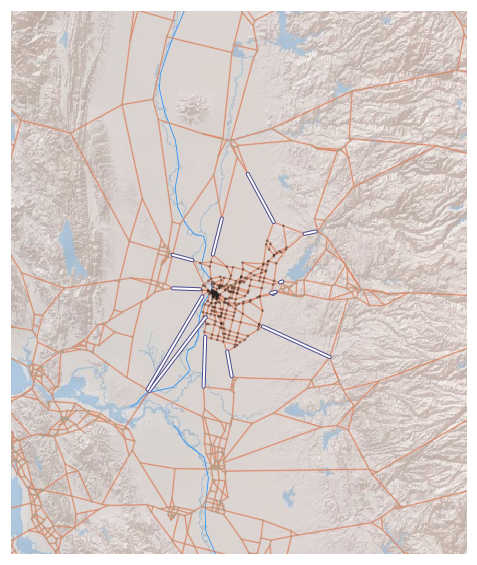

In [51]:
Sfi = lgc.flow_clustering(g, Scap, method="sl", delta=0.0)[0]
drawing, bm, ax = drawusmap()
myhighlight(drawing, Sfi)
zoomfig(g, Sfi, bm, ax, drawing, offset=0.75)
g.set_scores(Sfi)

## Metis partitions

In [52]:
import metis
import networkx as nx
edgecuts, parts = metis.part_graph(nG,2)
nG = nx.from_scipy_sparse_matrix(g.adjacency_matrix)
P1 = [i for i in range(g._num_vertices) if parts[i] == 0]
P = simplify_set(g,P1)
g.set_scores(P)

{'cond': 0.0006517235761003654,
 'cut': 56.0,
 'edgeseff': 85870.0,
 'edgestrue': 85870.0,
 'isop': 0.0022028164581858233,
 'sizeeff': 25422,
 'sizetrue': 25422,
 'voleff': 85926.0,
 'voltrue': 85926.0}

In [53]:
Sf = lgc.flow_clustering(g, P, method='mqi')[0]
g.set_scores(Sf)

{'cond': 0.0004964891127030286,
 'cut': 42.0,
 'edgeseff': 84552.0,
 'edgestrue': 84552.0,
 'isop': 0.0016777183031077734,
 'sizeeff': 25034,
 'sizetrue': 25034,
 'voleff': 84594.0,
 'voltrue': 84594.0}

In [54]:
Sf = lgc.flow_clustering(g, P, method='sl', delta=0.1)[0]
g.set_scores(Sf)

{'cond': 0.0004964891127030286,
 'cut': 42.0,
 'edgeseff': 84552.0,
 'edgestrue': 84552.0,
 'isop': 0.0016777183031077734,
 'sizeeff': 25034,
 'sizetrue': 25034,
 'voleff': 84594.0,
 'voltrue': 84594.0}

In [55]:
Sf = lgc.flow_clustering(g, P, method='sl', delta=0.0)[0]
g.set_scores(Sf)

{'cond': 0.0004964891127030286,
 'cut': 42.0,
 'edgeseff': 84552.0,
 'edgestrue': 84552.0,
 'isop': 0.0016777183031077734,
 'sizeeff': 25034,
 'sizetrue': 25034,
 'voleff': 84594.0,
 'voltrue': 84594.0}

In [56]:
g.set_scores(Sf)

{'cond': 0.0004964891127030286,
 'cut': 42.0,
 'edgeseff': 84552.0,
 'edgestrue': 84552.0,
 'isop': 0.0016777183031077734,
 'sizeeff': 25034,
 'sizetrue': 25034,
 'voleff': 84594.0,
 'voltrue': 84594.0}